# Basketball YOLOv5, 8 & 11
Dataset obtained in:

https://universe.roboflow.com/roboflow-universe-projects/basketball-players-fy4c2/dataset/25

Version YOLOv8, not modified:

95% Train set (1140 img)

3% Valid set (32 img)

2% Train set (24 img)

## Initial Libraries

In [1]:
import os
import random
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import cv2
from ultralytics import YOLO
from IPython.display import Video
import numpy as np  
import seaborn as sns
sns.set(style='darkgrid')
import pathlib
import glob
from tqdm.notebook import trange, tqdm
import warnings
warnings.filterwarnings('ignore')

## Plotting random train samples

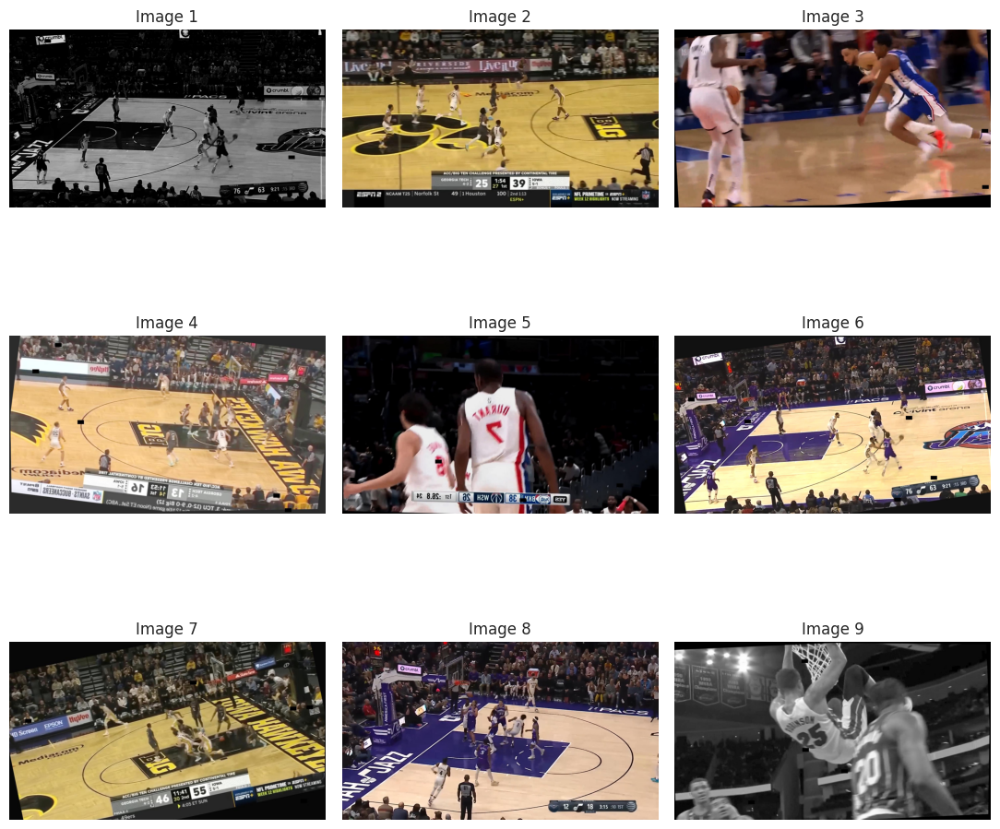

In [2]:
#Image directory for train samples
Image_dir = '/mnt/c/Users/alide/IA/Proyecto/BasketballYv8/train/images'

#To show samples
num_samples = 9
image_files = os.listdir(Image_dir)

# Randomly select num_samples images for plotting
rand_images = random.sample(image_files, num_samples)

fig, axes = plt.subplots(3, 3, figsize=(11, 11))

for i in range(num_samples):
    image = rand_images[i]
    ax = axes[i // 3, i % 3]
    ax.imshow(plt.imread(os.path.join(Image_dir, image)))
    ax.set_title(f'Image {i+1}')
    ax.axis('off')

plt.tight_layout()
plt.show()

## YOLOv8

In [3]:
# Use a pretrained YOLOv8n model
model = YOLO("yolov8n.pt") 


image 1/1 /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/test/images/youtube-128_jpg.rf.9c69a0f24eb15649f6d5bd2f1a9d47a2.jpg: 384x640 13 persons, 72.3ms
Speed: 5.4ms preprocess, 72.3ms inference, 5.8ms postprocess per image at shape (1, 3, 384, 640)


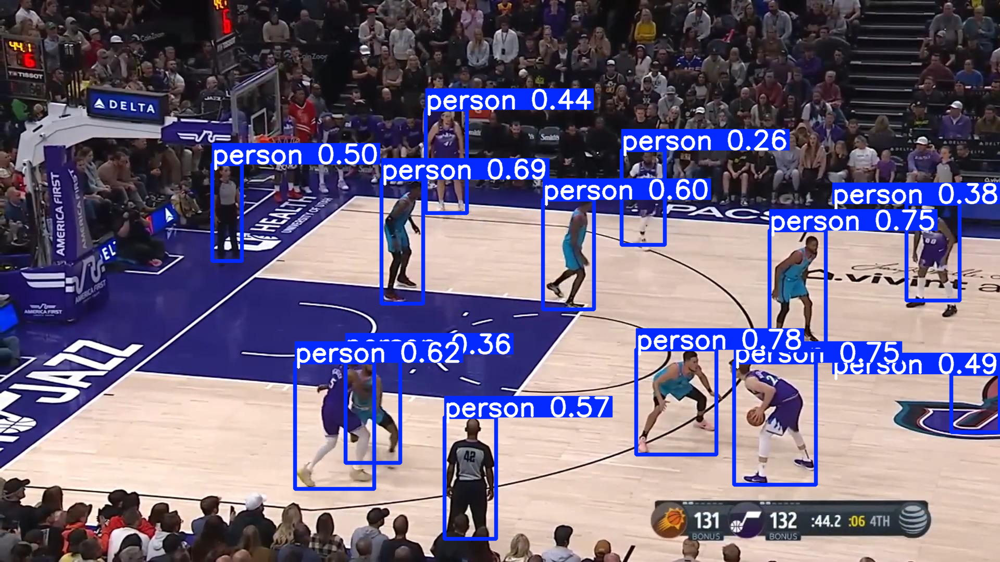

In [4]:
# Use the model to detect object
image_example = "/mnt/c/Users/alide/IA/Proyecto/BasketballYv8/test/images/youtube-128_jpg.rf.9c69a0f24eb15649f6d5bd2f1a9d47a2.jpg"
result_predict = model.predict(source = image_example, imgsz=(640))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

In [5]:
# Build from YAML and transfer weights
Training_model = YOLO('yolov8n.pt')

In [6]:
#Training
Result_Training_model = Training_model.train(data="/mnt/c/Users/alide/IA/Proyecto/BasketballYv8/data.yaml",
                                             epochs = 100, batch = 16, optimizer = 'auto')

Ultralytics 8.3.106 🚀 Python-3.10.14 torch-2.3.1+cu121 CPU (AMD Ryzen 5 5500)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/mnt/c/Users/alide/IA/Proyecto/BasketballYv8/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show

train: Scanning /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/train/labels.cache... 1140 images, 1 background
val: Scanning /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/valid/labels.cache... 32 images, 0 backgrounds, 0

Plotting labels to runs/detect/train/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000769, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      1.824      2.856      1.344        163        640: 100%|██████████| 72/72 [04:39
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.896     0.0883      0.141     0.0603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      2/100         0G      1.561      1.503      1.202        136        640: 100%|██████████| 72/72 [04:27
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.598      0.397      0.477      0.231

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      3/100         0G      1.471      1.238      1.155        122        640: 100%|██████████| 72/72 [04:27
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.649      0.539      0.605      0.351

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      4/100         0G      1.408      1.104      1.131         55        640: 100%|██████████| 72/72 [04:31
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.649      0.663      0.651      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100         0G       1.35      1.016      1.109        108        640: 100%|██████████| 72/72 [04:33
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.642      0.655      0.704       0.42

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      6/100         0G      1.318     0.9436      1.089         84        640: 100%|██████████| 72/72 [04:35
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.718      0.671        0.7      0.323

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      7/100         0G      1.281      0.902      1.077        118        640: 100%|██████████| 72/72 [04:24
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.696      0.729      0.753       0.43

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      8/100         0G      1.291     0.8963      1.071        166        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.765      0.688      0.755      0.464

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      9/100         0G      1.239     0.8511       1.05        138        640: 100%|██████████| 72/72 [04:24
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.761      0.738      0.788      0.501

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     10/100         0G      1.227     0.8273      1.046         79        640: 100%|██████████| 72/72 [04:24
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.79       0.76      0.775      0.476

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     11/100         0G      1.175      0.788      1.031         97        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.723      0.746      0.789      0.474

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     12/100         0G      1.168     0.7822      1.028         79        640: 100%|██████████| 72/72 [04:35
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.763      0.774      0.801      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100         0G      1.151     0.7531      1.018        190        640: 100%|██████████| 72/72 [04:35
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.786      0.777      0.805      0.518

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     14/100         0G      1.148     0.7433      1.014         64        640: 100%|██████████| 72/72 [04:33
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.861      0.771      0.815      0.514

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     15/100         0G      1.133     0.7222      1.008        132        640: 100%|██████████| 72/72 [04:26
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.829      0.767      0.814      0.516

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     16/100         0G      1.115     0.7051      1.004         81        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.783      0.762      0.815      0.514

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     17/100         0G      1.098     0.6954     0.9956         97        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.883       0.73      0.822      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     18/100         0G      1.088     0.6812     0.9923        130        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.766       0.78      0.816      0.477

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     19/100         0G      1.091     0.6701     0.9872        132        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.843      0.781      0.824      0.539

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     20/100         0G      1.068     0.6566     0.9823        103        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.81        0.8      0.819      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     21/100         0G       1.07     0.6545     0.9857         82        640: 100%|██████████| 72/72 [04:21
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.857      0.761      0.816      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     22/100         0G      1.046     0.6387     0.9731        136        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.872        0.8      0.845      0.543

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     23/100         0G      1.033     0.6353     0.9725         98        640: 100%|██████████| 72/72 [04:24
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.758      0.788      0.829      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100         0G      1.031     0.6228     0.9698        123        640: 100%|██████████| 72/72 [04:24
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.783      0.815      0.823      0.499

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     25/100         0G      1.021     0.6157     0.9663        110        640: 100%|██████████| 72/72 [04:33
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.808      0.814      0.822      0.516

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     26/100         0G      1.011     0.6139      0.966         95        640: 100%|██████████| 72/72 [04:36
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.793      0.823      0.834      0.544

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     27/100         0G      1.012     0.6055     0.9596        134        640: 100%|██████████| 72/72 [04:36
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.861      0.757      0.836      0.544

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     28/100         0G      1.012     0.5995     0.9607        102        640: 100%|██████████| 72/72 [04:28
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.862      0.806      0.843      0.554

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     29/100         0G     0.9908      0.592     0.9515         53        640: 100%|██████████| 72/72 [04:24
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.842      0.805      0.834      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     30/100         0G     0.9838     0.5861     0.9567        132        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.865      0.759      0.827      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     31/100         0G     0.9653     0.5755     0.9512         62        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.839      0.795      0.834      0.517

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     32/100         0G     0.9717     0.5744     0.9493        139        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.856      0.784      0.842      0.558

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     33/100         0G      0.992     0.5773     0.9542        113        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.834      0.798      0.833      0.545

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     34/100         0G     0.9576     0.5668     0.9397        124        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.849      0.803      0.831      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     35/100         0G     0.9374     0.5567     0.9384        108        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.876      0.784       0.83      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100         0G     0.9356     0.5598     0.9407        100        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.875      0.788      0.844      0.555

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     37/100         0G     0.9522     0.5592     0.9399        152        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.843      0.805      0.832      0.545

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     38/100         0G     0.9257     0.5499     0.9346        101        640: 100%|██████████| 72/72 [04:21
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.838      0.782      0.827      0.541

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     39/100         0G     0.9415     0.5524     0.9403         38        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.867       0.78      0.836      0.556

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     40/100         0G     0.9476     0.5517     0.9406         97        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.836      0.818       0.84       0.55

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     41/100         0G     0.9515     0.5482     0.9392        128        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.874      0.788      0.828       0.54

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     42/100         0G      0.902      0.531     0.9267         90        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.895      0.775      0.843      0.565

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     43/100         0G     0.9218     0.5335     0.9302        108        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.791      0.809      0.827      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     44/100         0G     0.8985     0.5274     0.9259         75        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.853      0.822      0.841      0.553

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     45/100         0G     0.8999     0.5227     0.9235         83        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.845       0.81      0.837      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100         0G     0.8989     0.5217     0.9226         62        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.847       0.81      0.831      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     47/100         0G     0.8947     0.5188     0.9241        105        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.837      0.823      0.832      0.553

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     48/100         0G     0.8868     0.5152     0.9235         44        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.822      0.805      0.836      0.548

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     49/100         0G     0.8882     0.5145     0.9216         93        640: 100%|██████████| 72/72 [04:21
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.793      0.807      0.822      0.546

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     50/100         0G     0.8772     0.5109     0.9193         69        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.853       0.79      0.834      0.557

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     51/100         0G     0.8797     0.5117     0.9214        131        640: 100%|██████████| 72/72 [04:21
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.867       0.78      0.842      0.564

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     52/100         0G     0.8644     0.5029     0.9159         95        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.859      0.786      0.835       0.55

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     53/100         0G     0.8728     0.5055     0.9141         78        640: 100%|██████████| 72/72 [04:24
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.856      0.779      0.831      0.553

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     54/100         0G     0.8819     0.5103     0.9164         80        640: 100%|██████████| 72/72 [04:24
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.833       0.81       0.84      0.549

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     55/100         0G     0.8608     0.4948     0.9137        111        640: 100%|██████████| 72/72 [04:24
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.909      0.773      0.849      0.563

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     56/100         0G     0.8523     0.4931     0.9084         84        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.884      0.771      0.837      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100         0G     0.8447     0.4899     0.9074         77        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.83        0.8      0.839      0.559

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     58/100         0G     0.8507     0.4916     0.9081         92        640: 100%|██████████| 72/72 [04:25
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.843      0.802       0.84      0.561

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     59/100         0G     0.8485     0.4893     0.9096         76        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.881      0.786      0.834      0.555

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     60/100         0G     0.8372     0.4817     0.9102         66        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.909      0.786      0.841      0.565

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     61/100         0G     0.8361     0.4845     0.9084         51        640: 100%|██████████| 72/72 [04:21
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.876      0.808      0.839      0.552

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     62/100         0G     0.8397     0.4843     0.9071         92        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.905      0.791      0.844      0.557

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     63/100         0G     0.8281     0.4816     0.9047        122        640: 100%|██████████| 72/72 [04:21
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.902      0.795      0.848      0.548

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     64/100         0G       0.82      0.475      0.901        135        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.878      0.801      0.842      0.555

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     65/100         0G      0.821     0.4719     0.9029        105        640: 100%|██████████| 72/72 [04:21
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.885      0.801      0.842      0.547

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     66/100         0G     0.8226     0.4751     0.9007         96        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.891      0.798      0.837       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100         0G      0.822     0.4739     0.9018        119        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.874      0.793      0.841      0.556

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     68/100         0G     0.8055     0.4654     0.8971        138        640: 100%|██████████| 72/72 [04:21
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.844      0.826      0.846      0.567

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     69/100         0G     0.8072     0.4666     0.9015         87        640: 100%|██████████| 72/72 [04:21
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.873      0.787       0.84      0.564

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     70/100         0G     0.7973     0.4613     0.8944        103        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.86       0.81      0.841      0.561

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     71/100         0G     0.8166     0.4631     0.8968         96        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.894       0.78      0.841      0.553

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     72/100         0G     0.7992     0.4614     0.8974        136        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.894      0.791      0.847      0.573

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     73/100         0G     0.7775     0.4536     0.8878        106        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.876      0.805      0.852      0.559

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     74/100         0G     0.8011     0.4587     0.8948        121        640: 100%|██████████| 72/72 [04:24
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.861      0.813      0.848      0.563

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     75/100         0G     0.7857     0.4557     0.8932         61        640: 100%|██████████| 72/72 [04:21
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.85      0.816      0.845      0.565

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     76/100         0G     0.7806     0.4527     0.8923         98        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.886      0.811      0.851      0.558

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     77/100         0G     0.7861     0.4511      0.891        101        640: 100%|██████████| 72/72 [04:21
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.89      0.807       0.85      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100         0G     0.7917     0.4504     0.8926         96        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.914      0.777      0.846      0.567

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     79/100         0G     0.7819     0.4467     0.8876        112        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.908      0.791      0.847      0.557

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     80/100         0G     0.7584     0.4422     0.8868        100        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.892      0.804      0.855      0.566

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     81/100         0G     0.7728     0.4458     0.8876         84        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.876      0.796      0.844      0.559

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     82/100         0G     0.7544     0.4399     0.8824         98        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.87      0.802      0.847      0.568

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     83/100         0G      0.754     0.4396     0.8829        120        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.903      0.785      0.846      0.567

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     84/100         0G     0.7716     0.4437     0.8865        123        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.91      0.797      0.846      0.558

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     85/100         0G     0.7553     0.4369     0.8836        112        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.877       0.82      0.847      0.562

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     86/100         0G     0.7586     0.4382     0.8848         79        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.865      0.821      0.843      0.556

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     87/100         0G     0.7545     0.4354     0.8825         88        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.86      0.819      0.839      0.558

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     88/100         0G     0.7368      0.428     0.8805         80        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.849      0.815      0.841      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100         0G     0.7384     0.4283     0.8789        117        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.843       0.82       0.84      0.564

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     90/100         0G     0.7449     0.4324     0.8788         72        640: 100%|██████████| 72/72 [04:22
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.897      0.786      0.837      0.562
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     91/100         0G     0.7228     0.4089     0.8593         66        640: 100%|██████████| 72/72 [04:12
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.879      0.781      0.832      0.546

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     92/100         0G     0.6911      0.387     0.8522         52        640: 100%|██████████| 72/72 [04:12
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.846      0.791      0.827      0.549

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     93/100         0G     0.6828     0.3831     0.8522         29        640: 100%|██████████| 72/72 [04:12
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.847       0.79      0.827      0.554

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     94/100         0G     0.6719     0.3759     0.8492         56        640: 100%|██████████| 72/72 [04:36
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.873      0.782      0.832      0.549

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     95/100         0G     0.6587      0.374     0.8454         35        640: 100%|██████████| 72/72 [04:31
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.868      0.792      0.829      0.552

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     96/100         0G     0.6692     0.3799     0.8466         55        640: 100%|██████████| 72/72 [04:37
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.86      0.794      0.834      0.552

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     97/100         0G     0.6534      0.371     0.8449         53        640: 100%|██████████| 72/72 [04:35
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.886      0.786      0.833       0.55

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     98/100         0G     0.6468     0.3676      0.843         42        640: 100%|██████████| 72/72 [04:36
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.868      0.798      0.832      0.556

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     99/100         0G     0.6468     0.3684     0.8426         42        640: 100%|██████████| 72/72 [04:35
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.847      0.811      0.834      0.552

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



    100/100         0G     0.6398     0.3662      0.841         51        640: 100%|██████████| 72/72 [04:36
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.857      0.804      0.833      0.554



100 epochs completed in 7.423 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.106 🚀 Python-3.10.14 torch-2.3.1+cu121 CPU (AMD Ryzen 5 5500)
Model summary (fused): 72 layers, 3,007,403 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1


                   all         32        477      0.894      0.791      0.847      0.572
                  Ball         18         18          1      0.277      0.371      0.221
                  Hoop         22         22      0.842      0.955      0.949      0.666
                Period         22         23       0.94      0.679      0.827      0.562
                Player         31        253      0.917      0.832      0.906      0.577
                   Ref         28         55      0.859      0.855      0.899       0.61
            Shot Clock         19         19      0.938      0.797       0.95      0.605
             Team Name         10         20      0.866        0.9      0.899      0.634
           Team Points         22         45       0.86      0.911      0.909      0.668
        Time Remaining         22         22      0.822      0.909       0.91      0.609
Speed: 0.9ms preprocess, 34.0ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs/detec

### Post-training Results

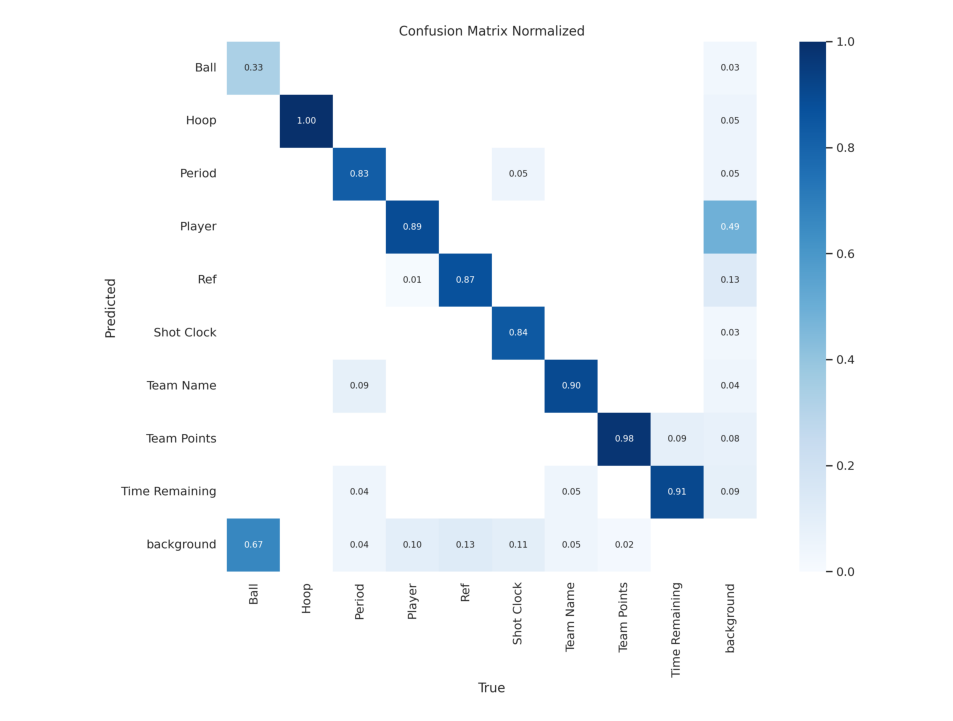

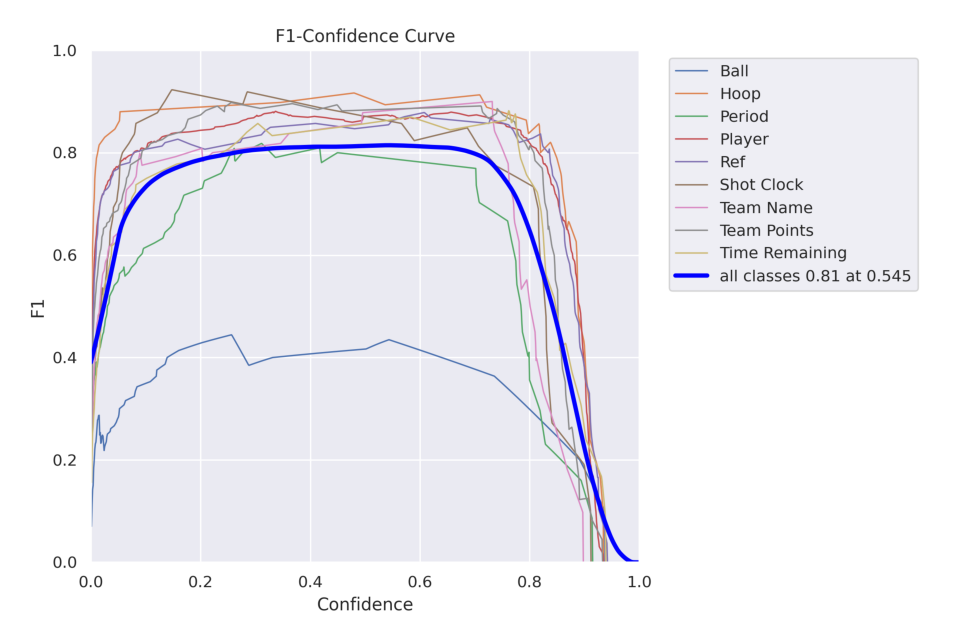

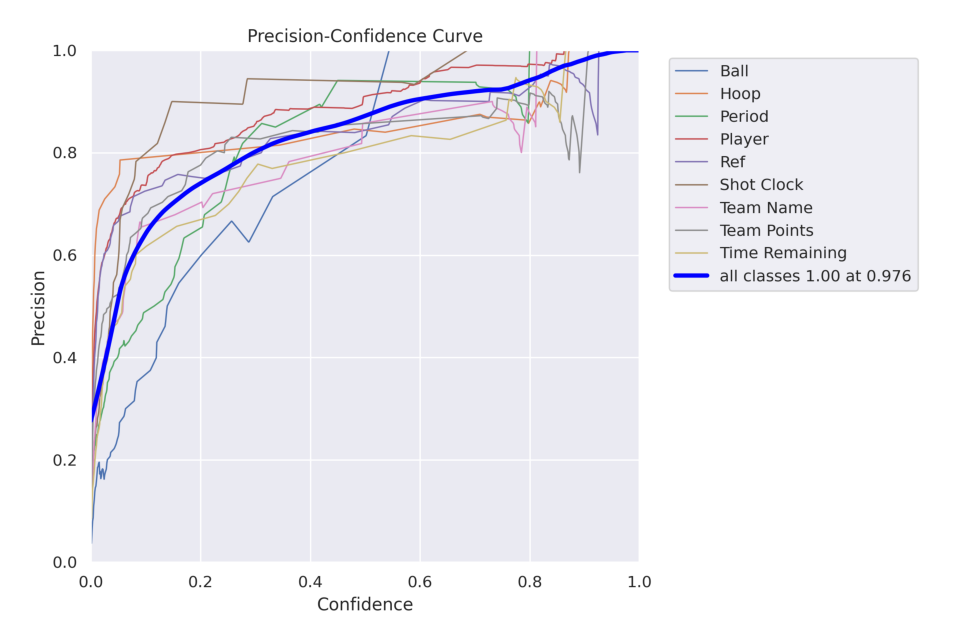

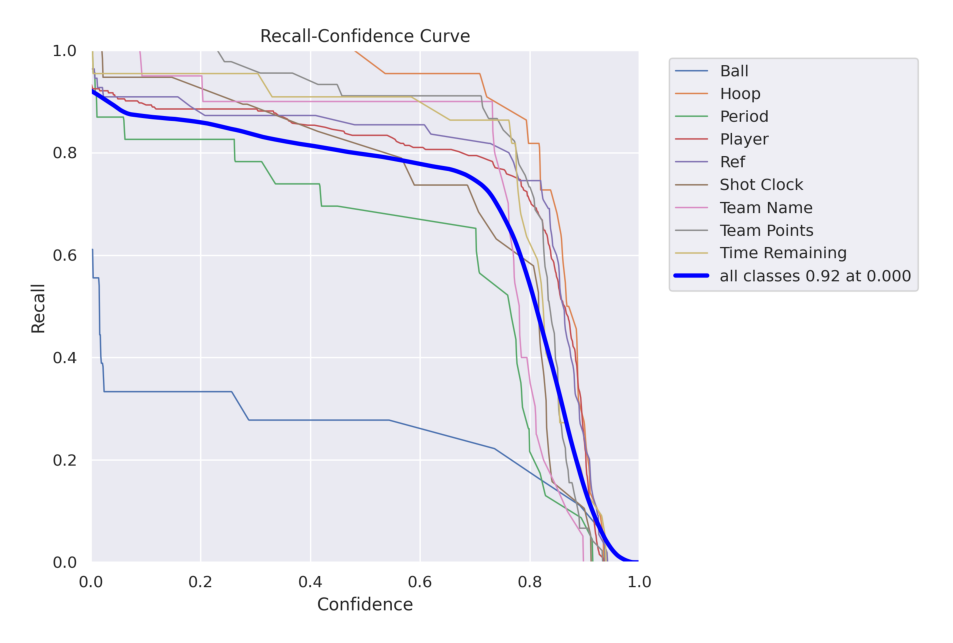

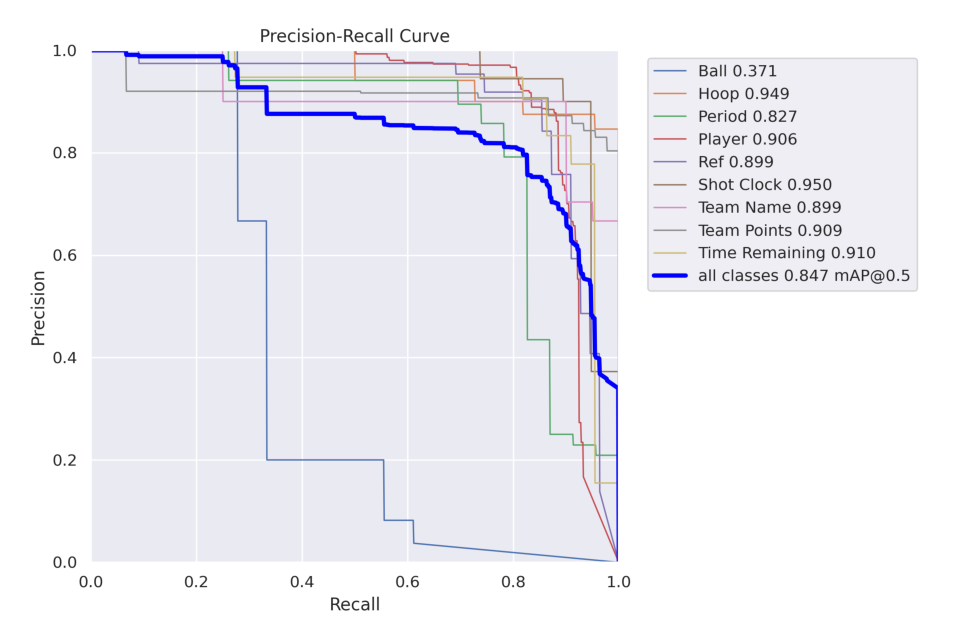

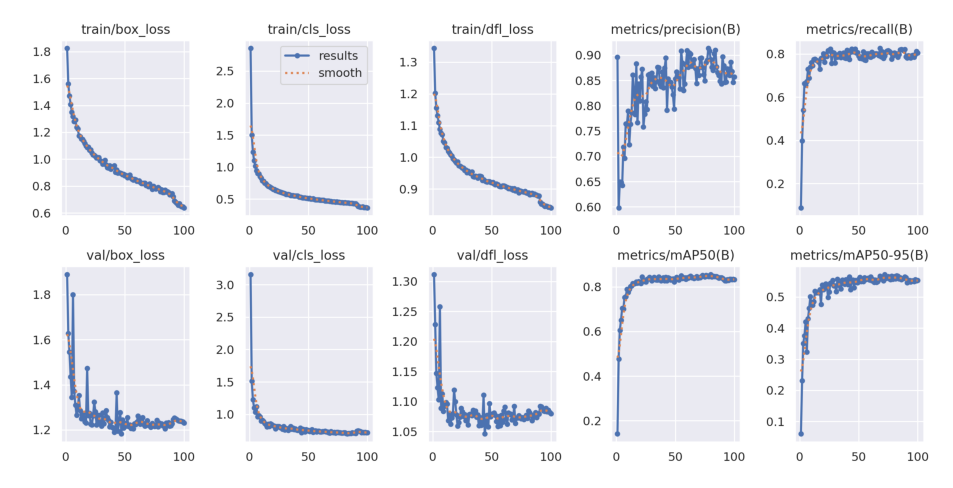

In [7]:
#Function for showing results
def display_images(post_training_files_path, image_files):

    for image_file in image_files:
        image_path = os.path.join(post_training_files_path, image_file)
        img = cv2.imread(image_path)
        if img is None:
            print(f"❌ Could not read image: {image_path}")
            continue
        
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        plt.figure(figsize=(10, 10), dpi=120)
        plt.imshow(img)
        plt.axis('off')
        plt.show()

# List of image files to display
image_files = [
    'confusion_matrix_normalized.png',
    'F1_curve.png',
    'P_curve.png',
    'R_curve.png',
    'PR_curve.png',
    'results.png'
]

# Path to the directory containing the images
post_training_files_path = '/home/alide/Notebooks/ProyectoPC/runs/detect/train'

# Display the images
display_images(post_training_files_path, image_files)

### Best performing model and example

In [8]:
# Loading the best performing model
Final_model_v8 = YOLO('/home/alide/Notebooks/ProyectoPC/runs/detect/train/weights/best.pt')

# Evaluating the model on the validset
metrics = Final_model_v8.val(split = 'val')

# final results 
print("precision(B): ", metrics.results_dict["metrics/precision(B)"])
print("metrics/recall(B): ", metrics.results_dict["metrics/recall(B)"])
print("metrics/mAP50(B): ", metrics.results_dict["metrics/mAP50(B)"])
print("metrics/mAP50-95(B): ", metrics.results_dict["metrics/mAP50-95(B)"])

Ultralytics 8.3.106 🚀 Python-3.10.14 torch-2.3.1+cu121 CPU (AMD Ryzen 5 5500)
Model summary (fused): 72 layers, 3,007,403 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/valid/labels.cache... 32 images, 0 backgrounds, 0
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2


                   all         32        477      0.894      0.791      0.847      0.572
                  Ball         18         18          1      0.277      0.371      0.221
                  Hoop         22         22      0.842      0.955      0.949      0.666
                Period         22         23       0.94      0.679      0.827      0.562
                Player         31        253      0.917      0.832      0.906      0.577
                   Ref         28         55      0.859      0.855      0.899       0.61
            Shot Clock         19         19      0.938      0.797       0.95      0.605
             Team Name         10         20      0.866        0.9      0.899      0.634
           Team Points         22         45       0.86      0.911      0.909      0.668
        Time Remaining         22         22      0.822      0.909       0.91      0.609
Speed: 0.6ms preprocess, 29.8ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs/detec

#### Exporting the model

In [9]:
#Export the model
Final_model_v8.export(format='onnx')

Ultralytics 8.3.106 🚀 Python-3.10.14 torch-2.3.1+cu121 CPU (AMD Ryzen 5 5500)

PyTorch: starting from '/home/alide/Notebooks/ProyectoPC/runs/detect/train/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 13, 8400) (5.9 MB)
requirements: Ultralytics requirement ['onnxslim'] not found, attempting AutoUpdate...
requirements: ❌ AutoUpdate skipped (offline)

ONNX: starting export with onnx 1.17.0 opset 17...
ONNX: simplifier failure: No module named 'onnxslim'
ONNX: export success ✅ 0.5s, saved as '/home/alide/Notebooks/ProyectoPC/runs/detect/train/weights/best.onnx' (11.7 MB)

Export complete (0.6s)
Results saved to /home/alide/Notebooks/ProyectoPC/runs/detect/train/weights
Predict:         yolo predict task=detect model=/home/alide/Notebooks/ProyectoPC/runs/detect/train/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=/home/alide/Notebooks/ProyectoPC/runs/detect/train/weights/best.onnx imgsz=640 data=/mnt/c/Users/alide/IA/Proyecto/Bas

'/home/alide/Notebooks/ProyectoPC/runs/detect/train/weights/best.onnx'

#### Example using Final_Model with the same img used with the pre trained model


image 1/1 /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/test/images/youtube-128_jpg.rf.9c69a0f24eb15649f6d5bd2f1a9d47a2.jpg: 384x640 1 Ball, 1 Hoop, 1 Period, 10 Players, 3 Refs, 1 Shot Clock, 2 Team Pointss, 1 Time Remaining, 42.2ms
Speed: 1.6ms preprocess, 42.2ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


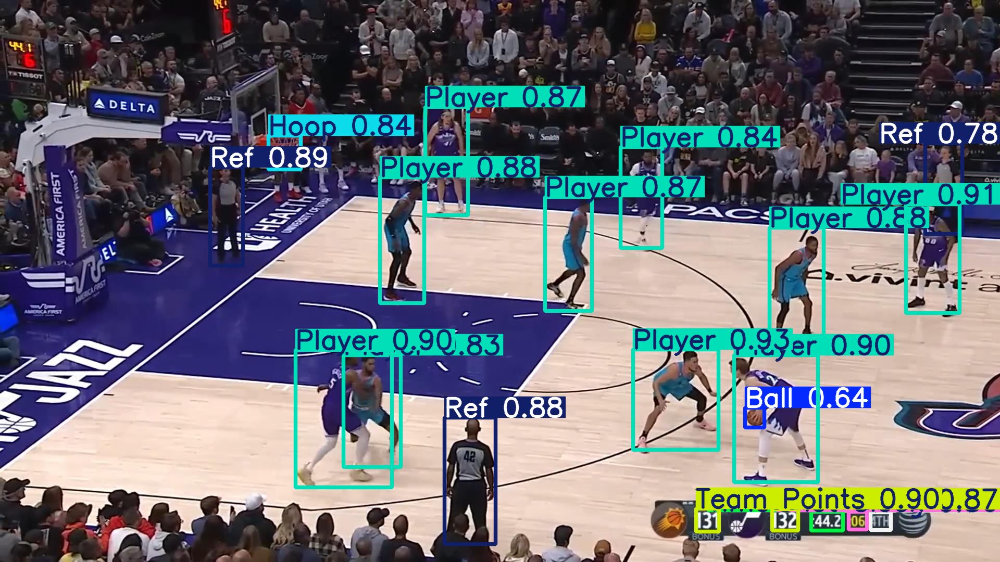

In [10]:
result_predict = Final_model_v8.predict(source = image_example, imgsz=(640))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

### FInal Model architecture

In [11]:
Final_model_v8

YOLO(
  (model): DetectionModel(
    (model): Sequential(
      (0): Conv(
        (conv): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (act): SiLU(inplace=True)
      )
      (1): Conv(
        (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (act): SiLU(inplace=True)
      )
      (2): C2f(
        (cv1): Conv(
          (conv): Conv2d(32, 32, kernel_size=(1, 1), stride=(1, 1))
          (act): SiLU(inplace=True)
        )
        (cv2): Conv(
          (conv): Conv2d(48, 32, kernel_size=(1, 1), stride=(1, 1))
          (act): SiLU(inplace=True)
        )
        (m): ModuleList(
          (0): Bottleneck(
            (cv1): Conv(
              (conv): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (act): SiLU(inplace=True)
            )
            (cv2): Conv(
              (conv): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (act): SiLU(inplace=True)
   

## YOLOv5 training


image 1/1 /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/test/images/youtube-128_jpg.rf.9c69a0f24eb15649f6d5bd2f1a9d47a2.jpg: 384x640 15 persons, 36.2ms
Speed: 1.4ms preprocess, 36.2ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


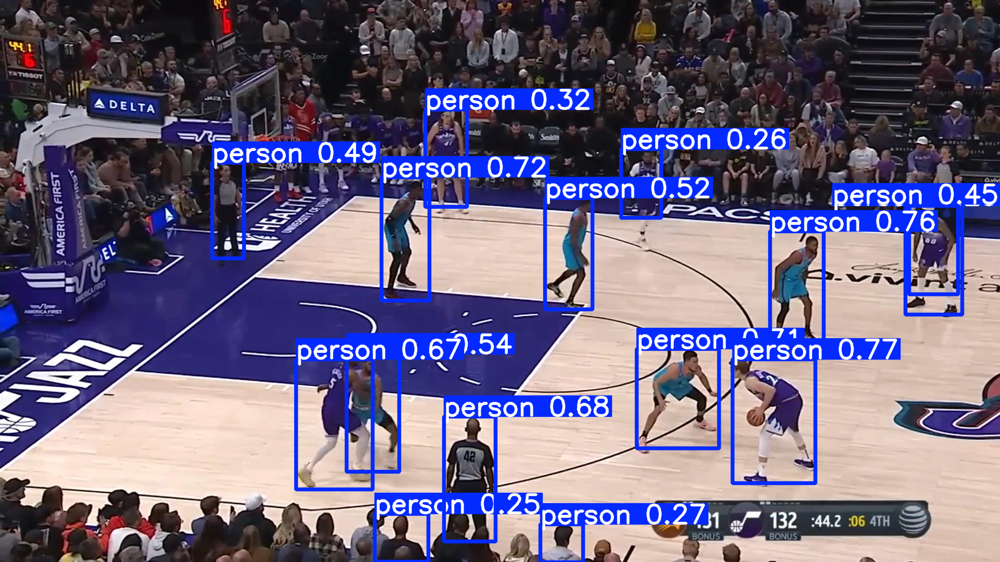

In [12]:
# Use a pretrained YOLOv5nu model
Training_model = YOLO("yolov5nu.pt") 

# Use the model to detect object
image = "/mnt/c/Users/alide/IA/Proyecto/BasketballYv8/train/images/youtube-1_jpg.rf.771c14fa7ff8ea51f5f1be48cba8e331.jpg"
result_predict = Training_model.predict(source = image_example, imgsz=(640))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

In [13]:
#Training
Result_Training_model = Training_model.train(data="/mnt/c/Users/alide/IA/Proyecto/BasketballYv8/data.yaml",
                                             epochs = 100, batch = 16, optimizer = 'auto')

Ultralytics 8.3.106 🚀 Python-3.10.14 torch-2.3.1+cu121 CPU (AMD Ryzen 5 5500)
engine/trainer: task=detect, mode=train, model=yolov5nu.pt, data=/mnt/c/Users/alide/IA/Proyecto/BasketballYv8/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, sh

train: Scanning /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/train/labels.cache... 1140 images, 1 background
val: Scanning /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/valid/labels.cache... 32 images, 0 backgrounds, 0

Plotting labels to runs/detect/train2/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000769, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train2
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      2.662      3.403      2.186        163        640: 100%|██████████| 72/72 [04:47
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.873      0.049     0.0652     0.0261

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      2/100         0G      2.104      1.994      1.572        136        640: 100%|██████████| 72/72 [04:47
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.637      0.157      0.177      0.085

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      3/100         0G      1.885      1.682      1.413        122        640: 100%|██████████| 72/72 [04:49
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.494      0.392      0.303      0.145

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      4/100         0G      1.766      1.487      1.334         55        640: 100%|██████████| 72/72 [04:42
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.657      0.342      0.391      0.206

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      5/100         0G      1.663      1.352       1.28        108        640: 100%|██████████| 72/72 [04:40
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.661      0.425       0.51       0.24

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      6/100         0G      1.606      1.233      1.242         84        640: 100%|██████████| 72/72 [04:40
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.574      0.546      0.525      0.235

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      7/100         0G      1.552      1.174      1.213        118        640: 100%|██████████| 72/72 [04:35
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.515      0.632      0.612      0.314



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G      1.551      1.145      1.203        166        640: 100%|██████████| 72/72 [04:37
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.597      0.662       0.64      0.332

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      9/100         0G      1.508      1.097       1.18        138        640: 100%|██████████| 72/72 [04:39
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.65      0.625      0.666      0.357

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     10/100         0G      1.475      1.061      1.165         79        640: 100%|██████████| 72/72 [04:36
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.694      0.609      0.642      0.331

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     11/100         0G      1.431      1.013      1.151         97        640: 100%|██████████| 72/72 [04:29
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.708      0.637      0.656      0.366

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     12/100         0G      1.401     0.9833      1.136         79        640: 100%|██████████| 72/72 [04:29
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.668      0.651      0.688      0.395

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     13/100         0G      1.387     0.9486      1.125        190        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.74      0.683      0.709      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100         0G      1.393     0.9368      1.124         64        640: 100%|██████████| 72/72 [04:12
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.787      0.681      0.725      0.397

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     15/100         0G      1.359     0.9172      1.106        132        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.751      0.722      0.749      0.404

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     16/100         0G      1.346     0.8944      1.104         81        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.766      0.725      0.738      0.428

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     17/100         0G       1.32     0.8737       1.09         97        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.759      0.718      0.747      0.428

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     18/100         0G      1.329     0.8676      1.091        130        640: 100%|██████████| 72/72 [04:12
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.786      0.698      0.756      0.449

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     19/100         0G      1.314     0.8533      1.079        132        640: 100%|██████████| 72/72 [04:11
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.722      0.714       0.74      0.438

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     20/100         0G      1.298     0.8386      1.076        103        640: 100%|██████████| 72/72 [04:12
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.743      0.741       0.76      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     21/100         0G      1.286     0.8244      1.076         82        640: 100%|██████████| 72/72 [04:12
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.769      0.741      0.766      0.444

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     22/100         0G      1.276     0.8112      1.068        136        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.771      0.739      0.774      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100         0G      1.263     0.8025      1.062         98        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.805      0.716      0.774      0.454

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     24/100         0G      1.263      0.792      1.059        123        640: 100%|██████████| 72/72 [04:12
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.772      0.716      0.771      0.456

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     25/100         0G      1.258     0.7873      1.059        110        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.819      0.729      0.774      0.447

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     26/100         0G      1.233     0.7743      1.052         95        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.753      0.742      0.755      0.455

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     27/100         0G      1.239     0.7677      1.045        134        640: 100%|██████████| 72/72 [04:12
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.781      0.764      0.787      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     28/100         0G       1.22     0.7567      1.043        102        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.791      0.755      0.785      0.484

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     29/100         0G      1.212     0.7563      1.037         53        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.851      0.761      0.807      0.471

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     30/100         0G      1.199     0.7452      1.041        132        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.808      0.757       0.78      0.456

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     31/100         0G      1.185     0.7318      1.034         62        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.814      0.778       0.79      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100         0G      1.194     0.7231      1.031        139        640: 100%|██████████| 72/72 [04:25
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.794      0.746      0.788      0.479

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     33/100         0G      1.189     0.7181       1.03        113        640: 100%|██████████| 72/72 [04:25
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.824      0.758      0.799      0.481

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     34/100         0G       1.19     0.7164      1.023        124        640: 100%|██████████| 72/72 [04:27
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477        0.8      0.742      0.806      0.488

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     35/100         0G      1.177       0.71      1.024        108        640: 100%|██████████| 72/72 [04:20
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477        0.8      0.774       0.79      0.477

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     36/100         0G      1.148     0.7032      1.018        100        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.857      0.711      0.796      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     37/100         0G      1.162      0.702      1.017        152        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.848      0.763      0.798      0.484

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     38/100         0G       1.16     0.7022      1.017        101        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477        0.8       0.76      0.794      0.485

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     39/100         0G      1.162     0.6944       1.02         38        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.864      0.737      0.798      0.489

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     40/100         0G      1.144     0.6884      1.012         97        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.851      0.743      0.804      0.493

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     41/100         0G      1.156     0.6883      1.013        128        640: 100%|██████████| 72/72 [04:16
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.887      0.726      0.804      0.501

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     42/100         0G      1.118     0.6742      1.003         90        640: 100%|██████████| 72/72 [04:20
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.88      0.718      0.806      0.502

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     43/100         0G      1.137     0.6753      1.009        108        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.859      0.753      0.813      0.491

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     44/100         0G      1.132     0.6716      1.006         75        640: 100%|██████████| 72/72 [04:12
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.891       0.74      0.806      0.502

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     45/100         0G      1.128      0.664      1.003         83        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.901      0.757      0.806      0.496

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     46/100         0G      1.109     0.6617     0.9945         62        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.851      0.743      0.808      0.505

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     47/100         0G      1.103     0.6616     0.9952        105        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.847      0.758      0.801      0.502

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     48/100         0G      1.097     0.6529      0.996         44        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.875      0.735      0.817      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     49/100         0G        1.1     0.6521     0.9941         93        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.874       0.76      0.812      0.509

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     50/100         0G      1.103      0.658     0.9952         69        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.875      0.744      0.806       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     51/100         0G      1.089      0.655     0.9945        131        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.836       0.76      0.803      0.503

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     52/100         0G      1.093     0.6464     0.9915         95        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.863      0.738      0.803       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     53/100         0G      1.096      0.647     0.9902         78        640: 100%|██████████| 72/72 [04:15
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.871      0.716      0.805      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     54/100         0G      1.095     0.6448     0.9888         80        640: 100%|██████████| 72/72 [04:15
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.839      0.768      0.804      0.512

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     55/100         0G      1.071     0.6328     0.9851        111        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.883      0.738      0.812      0.512

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     56/100         0G      1.073     0.6304     0.9814         84        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.879      0.762      0.815      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     57/100         0G      1.081     0.6334     0.9856         77        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.873      0.765      0.813      0.516

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     58/100         0G      1.075     0.6331     0.9827         92        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.869      0.761      0.812      0.507

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     59/100         0G       1.07     0.6245     0.9839         76        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.856      0.779      0.827      0.512

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     60/100         0G      1.046     0.6203      0.982         66        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.824      0.789      0.805      0.518

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     61/100         0G      1.057     0.6257     0.9815         51        640: 100%|██████████| 72/72 [04:16
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.829       0.78      0.815      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     62/100         0G      1.066     0.6253     0.9791         92        640: 100%|██████████| 72/72 [04:15
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.861      0.745      0.807      0.509

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     63/100         0G      1.052     0.6207     0.9785        122        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.878      0.756      0.816      0.505

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     64/100         0G      1.049     0.6173      0.977        135        640: 100%|██████████| 72/72 [04:25
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.861      0.787      0.832      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     65/100         0G      1.043     0.6124     0.9771        105        640: 100%|██████████| 72/72 [04:26
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.872      0.775      0.833      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     66/100         0G      1.048     0.6169     0.9745         96        640: 100%|██████████| 72/72 [04:26
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.822      0.767      0.816      0.516

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     67/100         0G      1.039     0.6117      0.972        119        640: 100%|██████████| 72/72 [04:20
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.878      0.748      0.819      0.512

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     68/100         0G      1.028     0.6028      0.968        138        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.831      0.776      0.824      0.518

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     69/100         0G      1.033     0.6047     0.9746         87        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.886      0.746      0.828      0.518

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     70/100         0G      1.026     0.6009     0.9659        103        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.852      0.774      0.829      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     71/100         0G      1.027     0.5938     0.9677         96        640: 100%|██████████| 72/72 [04:12
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.851      0.759      0.811      0.518

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     72/100         0G      1.029      0.606     0.9732        136        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.889      0.777      0.833      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     73/100         0G      1.013     0.5938     0.9621        106        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.906       0.75      0.831      0.526

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     74/100         0G      1.027     0.5986     0.9664        121        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.817        0.8      0.833      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     75/100         0G      1.008     0.5952      0.965         61        640: 100%|██████████| 72/72 [04:12
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.853      0.772      0.824      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     76/100         0G      1.006      0.592     0.9642         98        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.836       0.78      0.825      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     77/100         0G      1.005     0.5904      0.962        101        640: 100%|██████████| 72/72 [04:23
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.887      0.751      0.829      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     78/100         0G       1.01     0.5886     0.9645         96        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.884      0.734      0.818      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     79/100         0G      1.004     0.5879     0.9599        112        640: 100%|██████████| 72/72 [04:14
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.872      0.764      0.825      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     80/100         0G      1.003     0.5865     0.9637        100        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.875      0.759      0.825      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     81/100         0G      1.001     0.5859     0.9609         84        640: 100%|██████████| 72/72 [04:20
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.888      0.762      0.831      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     82/100         0G     0.9942     0.5842     0.9557         98        640: 100%|██████████| 72/72 [04:15
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.884      0.776      0.828      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     83/100         0G     0.9956      0.582      0.956        120        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.826      0.807      0.832      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     84/100         0G      0.993     0.5829     0.9557        123        640: 100%|██████████| 72/72 [04:15
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.823      0.788      0.825       0.52

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     85/100         0G     0.9893     0.5785     0.9544        112        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.878      0.779      0.833      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     86/100         0G     0.9974     0.5829      0.959         79        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.86      0.774      0.829      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     87/100         0G     0.9949     0.5812      0.958         88        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.882      0.786      0.838      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     88/100         0G     0.9714     0.5688     0.9512         80        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.818      0.778      0.816      0.526

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     89/100         0G     0.9772     0.5683     0.9529        117        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.87      0.747      0.827      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     90/100         0G     0.9819     0.5733     0.9525         72        640: 100%|██████████| 72/72 [04:13
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.839      0.769      0.824      0.526
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     91/100         0G      0.973     0.5619     0.9409         66        640: 100%|██████████| 72/72 [04:04
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.795      0.799      0.816      0.502

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     92/100         0G     0.9497     0.5357     0.9327         52        640: 100%|██████████| 72/72 [04:04
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.804        0.8      0.818      0.516

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     93/100         0G     0.9265     0.5253     0.9266         29        640: 100%|██████████| 72/72 [04:04
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.852      0.785      0.819      0.514

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     94/100         0G     0.9134     0.5163      0.924         56        640: 100%|██████████| 72/72 [04:05
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.85      0.784      0.825      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     95/100         0G     0.9051     0.5127     0.9203         35        640: 100%|██████████| 72/72 [04:03
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.837      0.799      0.831      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     96/100         0G     0.9259     0.5251     0.9248         55        640: 100%|██████████| 72/72 [04:03
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.853      0.788      0.828      0.517

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     97/100         0G     0.9024     0.5126     0.9187         53        640: 100%|██████████| 72/72 [04:03
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.847       0.78      0.826      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     98/100         0G     0.9011     0.5091     0.9189         42        640: 100%|██████████| 72/72 [04:03
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.857      0.777      0.826      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     99/100         0G     0.8983     0.5099     0.9187         42        640: 100%|██████████| 72/72 [04:03
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.851      0.782      0.828      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



    100/100         0G     0.8952     0.5081     0.9159         51        640: 100%|██████████| 72/72 [04:03
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.847      0.785      0.826       0.52

100 epochs completed in 7.206 hours.


Optimizer stripped from runs/detect/train2/weights/last.pt, 5.3MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 5.3MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.106 🚀 Python-3.10.14 torch-2.3.1+cu121 CPU (AMD Ryzen 5 5500)
YOLOv5n summary (fused): 84 layers, 2,504,699 parameters, 0 gradients, 7.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1


                   all         32        477       0.86      0.774      0.829      0.534
                  Ball         18         18      0.804      0.278      0.319      0.174
                  Hoop         22         22      0.837      0.909      0.925      0.641
                Period         22         23      0.905      0.696      0.871      0.519
                Player         31        253      0.891       0.85      0.913      0.554
                   Ref         28         55      0.835        0.8      0.826      0.555
            Shot Clock         19         19      0.935      0.789      0.922      0.558
             Team Name         10         20      0.854      0.876       0.85      0.552
           Team Points         22         45      0.877      0.867      0.916       0.63
        Time Remaining         22         22      0.799      0.904       0.92      0.626
Speed: 0.9ms preprocess, 30.3ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs/detec

### Post-training Results

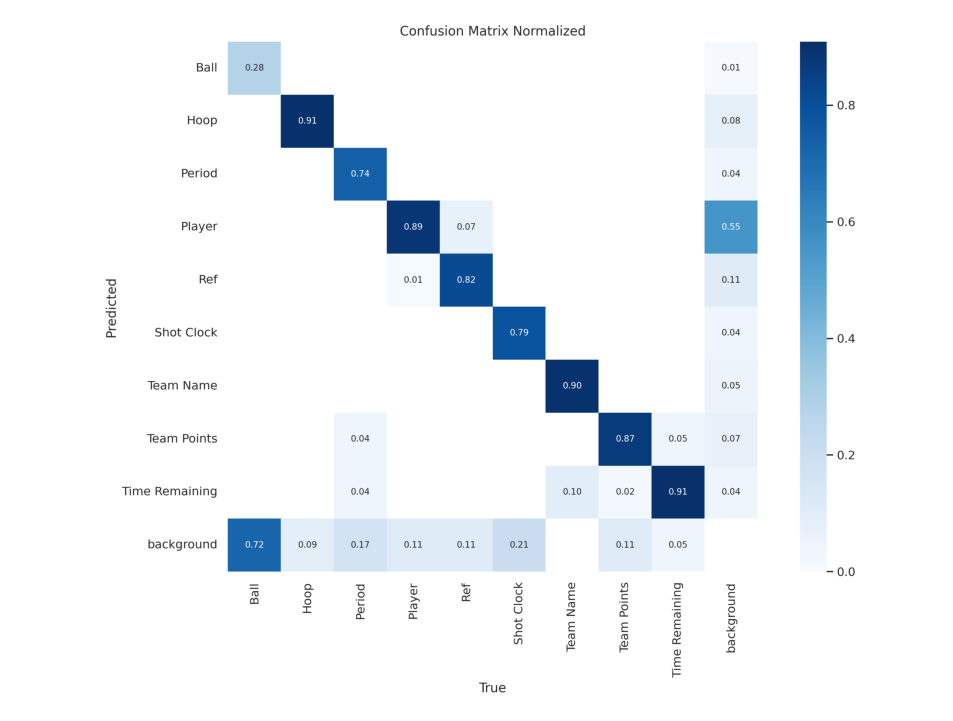

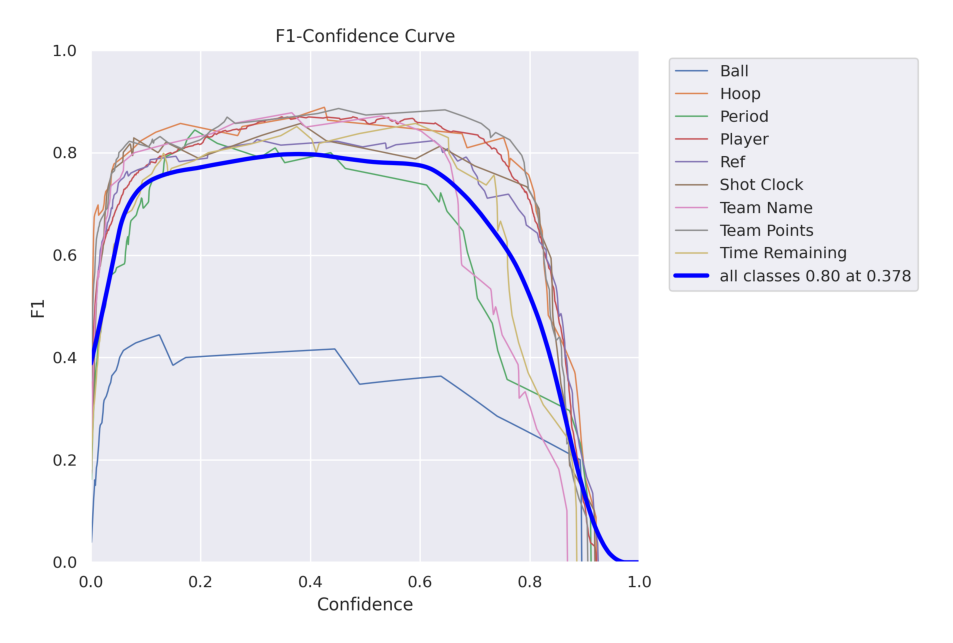

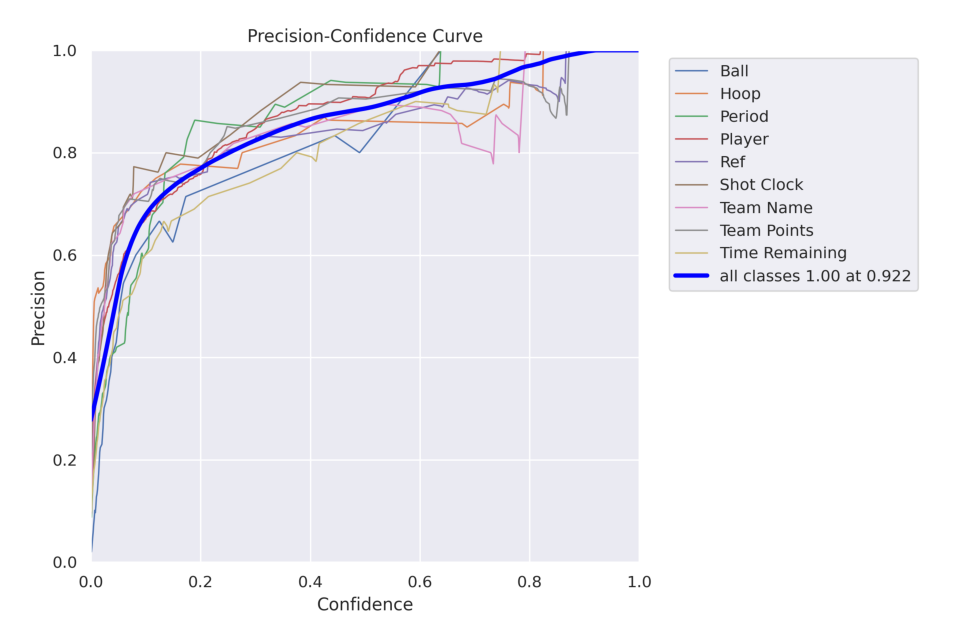

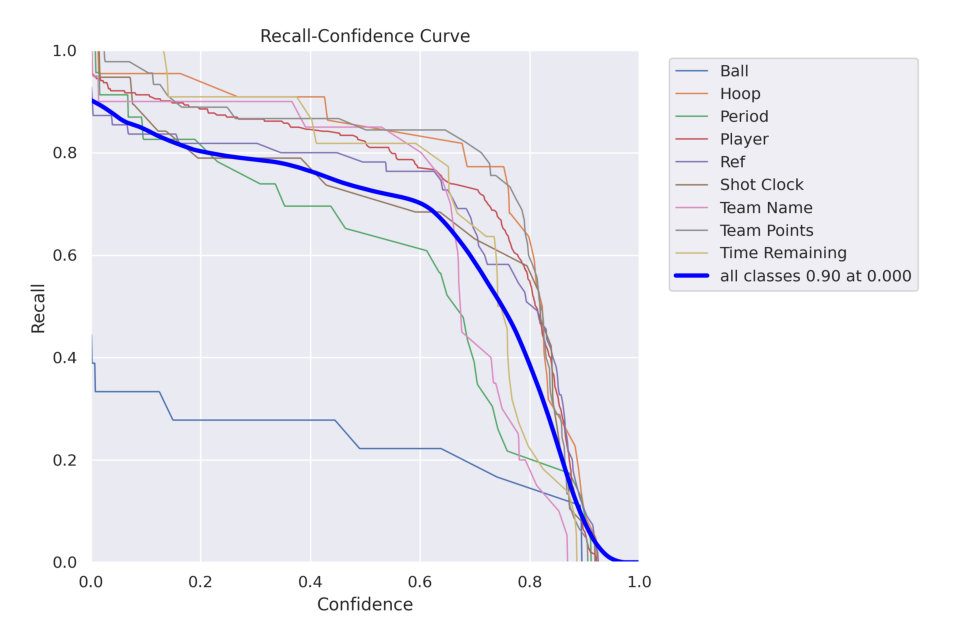

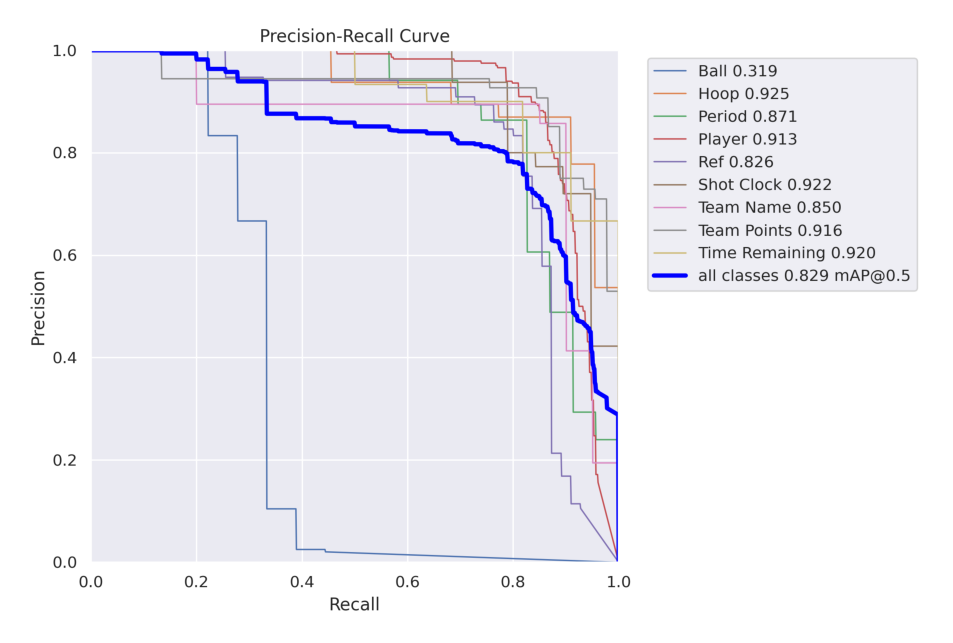

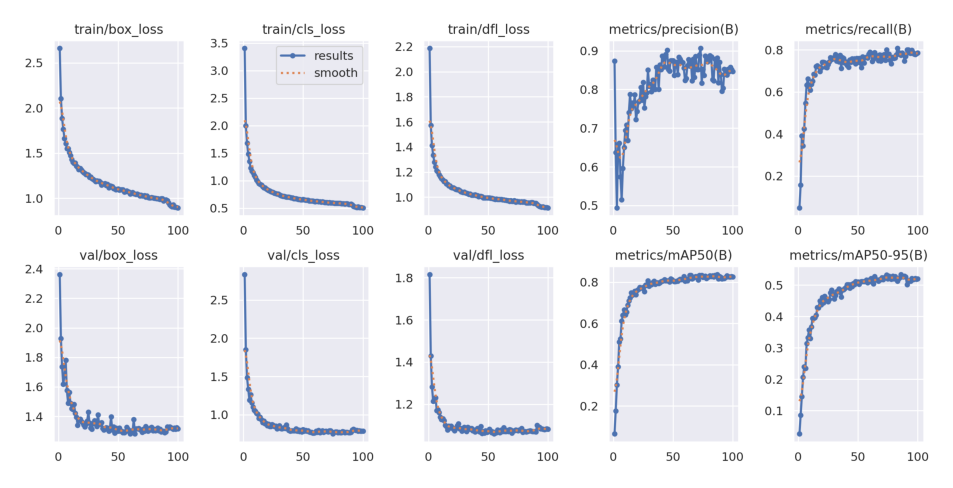

In [14]:
# Path to the directory containing the images
post_training_files_path = '/home/alide/Notebooks/ProyectoPC/runs/detect/train2'

# Display the images
display_images(post_training_files_path, image_files)

### Best performing model and example

In [15]:
# Loading the best performing model
Final_model_v5 = YOLO('/home/alide/Notebooks/ProyectoPC/runs/detect/train2/weights/best.pt')

# Evaluating the model on the validset
metrics = Final_model_v5.val(split = 'val')

# final results 
print("precision(B): ", metrics.results_dict["metrics/precision(B)"])
print("metrics/recall(B): ", metrics.results_dict["metrics/recall(B)"])
print("metrics/mAP50(B): ", metrics.results_dict["metrics/mAP50(B)"])
print("metrics/mAP50-95(B): ", metrics.results_dict["metrics/mAP50-95(B)"])

Ultralytics 8.3.106 🚀 Python-3.10.14 torch-2.3.1+cu121 CPU (AMD Ryzen 5 5500)
YOLOv5n summary (fused): 84 layers, 2,504,699 parameters, 0 gradients, 7.1 GFLOPs


val: Scanning /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/valid/labels.cache... 32 images, 0 backgrounds, 0
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2


                   all         32        477       0.86      0.774      0.829      0.534
                  Ball         18         18      0.804      0.278      0.319      0.174
                  Hoop         22         22      0.837      0.909      0.925      0.641
                Period         22         23      0.905      0.696      0.871      0.519
                Player         31        253      0.891       0.85      0.913      0.554
                   Ref         28         55      0.835        0.8      0.826      0.555
            Shot Clock         19         19      0.935      0.789      0.922      0.558
             Team Name         10         20      0.854      0.876       0.85      0.552
           Team Points         22         45      0.877      0.867      0.916       0.63
        Time Remaining         22         22      0.799      0.904       0.92      0.626
Speed: 0.6ms preprocess, 26.8ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs/detec

#### Exporting the model

In [16]:
#Export the model
Final_model_v5.export(format='onnx')

Ultralytics 8.3.106 🚀 Python-3.10.14 torch-2.3.1+cu121 CPU (AMD Ryzen 5 5500)

PyTorch: starting from '/home/alide/Notebooks/ProyectoPC/runs/detect/train2/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 13, 8400) (5.0 MB)
requirements: Ultralytics requirement ['onnxslim'] not found, attempting AutoUpdate...
requirements: ❌ AutoUpdate skipped (offline)

ONNX: starting export with onnx 1.17.0 opset 17...
ONNX: simplifier failure: No module named 'onnxslim'
ONNX: export success ✅ 0.4s, saved as '/home/alide/Notebooks/ProyectoPC/runs/detect/train2/weights/best.onnx' (9.8 MB)

Export complete (0.6s)
Results saved to /home/alide/Notebooks/ProyectoPC/runs/detect/train2/weights
Predict:         yolo predict task=detect model=/home/alide/Notebooks/ProyectoPC/runs/detect/train2/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=/home/alide/Notebooks/ProyectoPC/runs/detect/train2/weights/best.onnx imgsz=640 data=/mnt/c/Users/alide/IA/Proyecto

'/home/alide/Notebooks/ProyectoPC/runs/detect/train2/weights/best.onnx'

#### Example using Final_Model with the same img used with the pre trained model


image 1/1 /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/test/images/youtube-128_jpg.rf.9c69a0f24eb15649f6d5bd2f1a9d47a2.jpg: 384x640 1 Hoop, 1 Period, 10 Players, 5 Refs, 1 Shot Clock, 2 Team Pointss, 1 Time Remaining, 34.2ms
Speed: 1.6ms preprocess, 34.2ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


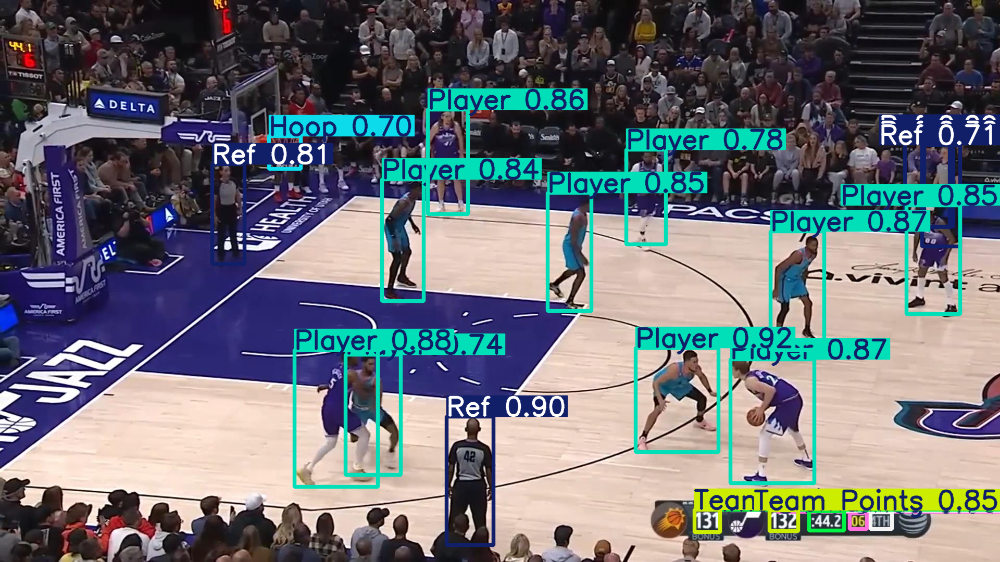

In [17]:
result_predict = Final_model_v5.predict(source = image_example, imgsz=(640))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

### FInal Model architecture

In [18]:
Final_model_v5

YOLO(
  (model): DetectionModel(
    (model): Sequential(
      (0): Conv(
        (conv): Conv2d(3, 16, kernel_size=(6, 6), stride=(2, 2), padding=(2, 2))
        (act): SiLU(inplace=True)
      )
      (1): Conv(
        (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (act): SiLU(inplace=True)
      )
      (2): C3(
        (cv1): Conv(
          (conv): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1))
          (act): SiLU(inplace=True)
        )
        (cv2): Conv(
          (conv): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1))
          (act): SiLU(inplace=True)
        )
        (cv3): Conv(
          (conv): Conv2d(32, 32, kernel_size=(1, 1), stride=(1, 1))
          (act): SiLU(inplace=True)
        )
        (m): Sequential(
          (0): Bottleneck(
            (cv1): Conv(
              (conv): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1))
              (act): SiLU(inplace=True)
            )
            (cv2): Conv(
             

## YOLOv11 training

100%|██████████████████████████████████████████████████████████████████| 5.35M/5.35M [00:00<00:00, 8.46MB/s]


image 1/1 /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/test/images/youtube-128_jpg.rf.9c69a0f24eb15649f6d5bd2f1a9d47a2.jpg: 384x640 15 persons, 47.5ms
Speed: 1.7ms preprocess, 47.5ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


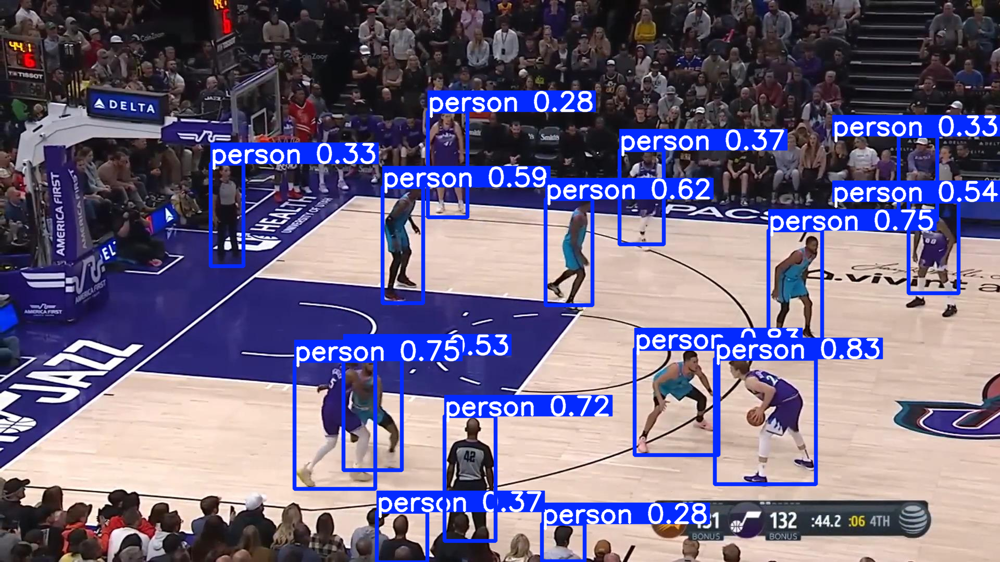

In [20]:
# Use a pretrained YOLOv5nu model
Training_model = YOLO("yolo11n.pt") 

# Use the model to detect object
image = "/mnt/c/Users/alide/IA/Proyecto/BasketballYv8/train/images/youtube-1_jpg.rf.771c14fa7ff8ea51f5f1be48cba8e331.jpg"
result_predict = Training_model.predict(source = image_example, imgsz=(640))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

In [21]:
#Training
Result_Training_model = Training_model.train(data="/mnt/c/Users/alide/IA/Proyecto/BasketballYv8/data.yaml",
                                             epochs = 100, batch = 16, optimizer = 'auto')

Ultralytics 8.3.106 🚀 Python-3.10.14 torch-2.3.1+cu121 CPU (AMD Ryzen 5 5500)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/mnt/c/Users/alide/IA/Proyecto/BasketballYv8/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, sho

train: Scanning /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/train/labels.cache... 1140 images, 1 background
val: Scanning /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/valid/labels.cache... 32 images, 0 backgrounds, 0

Plotting labels to runs/detect/train3/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000769, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train3
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G       2.68      3.985      2.305        163        640: 100%|██████████| 72/72 [04:49
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477     0.0102     0.0767     0.0148    0.00566

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      2/100         0G      2.125      2.331      1.672        136        640: 100%|██████████| 72/72 [04:47
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.654      0.169      0.121      0.056



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100         0G      1.879      1.787      1.463        122        640: 100%|██████████| 72/72 [04:58
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.512      0.246      0.218      0.108

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      4/100         0G      1.743      1.557      1.364         55        640: 100%|██████████| 72/72 [05:04
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.412      0.349      0.344      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100         0G      1.633      1.397      1.299        108        640: 100%|██████████| 72/72 [05:04
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.551      0.509      0.439      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100         0G      1.584      1.288      1.259         84        640: 100%|██████████| 72/72 [04:47
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.82      0.411       0.51       0.25

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      7/100         0G      1.522      1.211      1.222        118        640: 100%|██████████| 72/72 [04:46
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.487      0.557      0.523      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G      1.503      1.171      1.201        166        640: 100%|██████████| 72/72 [04:48
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.579       0.55      0.569       0.32

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      9/100         0G      1.467      1.105      1.177        138        640: 100%|██████████| 72/72 [04:46
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.619      0.545      0.588      0.335

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     10/100         0G      1.428      1.061      1.159         79        640: 100%|██████████| 72/72 [04:46
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477        0.6      0.604      0.603      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100         0G      1.403      1.024      1.148         97        640: 100%|██████████| 72/72 [04:47
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.622        0.6       0.61      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100         0G      1.362     0.9835      1.125         79        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.613      0.632      0.625      0.343

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     13/100         0G      1.346     0.9511      1.112        190        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.647      0.647      0.658      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100         0G      1.342     0.9394      1.107         64        640: 100%|██████████| 72/72 [04:47
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.656      0.655      0.653      0.384

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     15/100         0G      1.323     0.9111      1.097        132        640: 100%|██████████| 72/72 [04:46
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.67       0.63      0.655      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100         0G      1.309      0.886      1.091         81        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.673      0.658      0.663      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100         0G      1.287     0.8701      1.078         97        640: 100%|██████████| 72/72 [04:47
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.661      0.723      0.671      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100         0G       1.28      0.857      1.075        130        640: 100%|██████████| 72/72 [04:42
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.687      0.662      0.692      0.405

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     19/100         0G      1.264     0.8285      1.063        132        640: 100%|██████████| 72/72 [04:42
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.703      0.631      0.682      0.422

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     20/100         0G      1.252     0.8199      1.061        103        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.71      0.687      0.711      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100         0G      1.232     0.8058      1.057         82        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.742      0.644      0.711      0.426

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     22/100         0G      1.229     0.7963      1.052        136        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.659      0.739      0.717      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100         0G      1.208     0.7828      1.042         98        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.728      0.639      0.699      0.422

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     24/100         0G      1.201     0.7669      1.038        123        640: 100%|██████████| 72/72 [04:42
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.724      0.738      0.728       0.44

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     25/100         0G      1.204     0.7588      1.039        110        640: 100%|██████████| 72/72 [04:42
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.746      0.691       0.71      0.422

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     26/100         0G      1.184     0.7496      1.034         95        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.771      0.684       0.74      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100         0G      1.186     0.7391      1.025        134        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.77      0.723      0.741      0.453

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     28/100         0G       1.17     0.7316      1.023        102        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.722      0.753      0.759      0.434

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     29/100         0G       1.16     0.7237      1.018         53        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477        0.7      0.739      0.733      0.427

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     30/100         0G      1.148     0.7172      1.021        132        640: 100%|██████████| 72/72 [04:42
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.756      0.719      0.742      0.431

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     31/100         0G       1.14     0.7063      1.017         62        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.842      0.683      0.763      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100         0G      1.143     0.7023      1.012        139        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.717      0.741      0.745      0.456

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     33/100         0G      1.131     0.6913      1.011        113        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.784      0.728      0.754      0.459

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     34/100         0G      1.134     0.6891      1.004        124        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.762        0.7      0.746      0.443

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     35/100         0G      1.125     0.6844      1.007        108        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.724      0.762      0.755      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100         0G      1.103     0.6771      1.002        100        640: 100%|██████████| 72/72 [04:51
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.773      0.763      0.761       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100         0G      1.107     0.6724     0.9978        152        640: 100%|██████████| 72/72 [04:49
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.777      0.733      0.761      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     38/100         0G      1.105     0.6728     0.9981        101        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.793      0.749       0.76       0.47

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     39/100         0G      1.099     0.6693     0.9959         38        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.746      0.754      0.759      0.465

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     40/100         0G      1.091     0.6601     0.9925         97        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.802      0.744      0.776      0.477

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     41/100         0G      1.091     0.6561     0.9906        128        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.795      0.735      0.777       0.47

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     42/100         0G      1.079     0.6483     0.9872         90        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.776      0.775       0.77      0.481

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     43/100         0G      1.082     0.6461     0.9886        108        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.841      0.693      0.765      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100         0G      1.085      0.644     0.9867         75        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.807      0.757      0.778       0.48

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     45/100         0G      1.077     0.6376     0.9849         83        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.779      0.771      0.782      0.481

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     46/100         0G      1.062     0.6327     0.9786         62        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.775      0.761      0.784        0.5

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     47/100         0G      1.051     0.6319     0.9772        105        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.803      0.741      0.776      0.494

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     48/100         0G      1.045     0.6243      0.979         44        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.844      0.737      0.782      0.495

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     49/100         0G      1.048      0.625     0.9778         93        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.791      0.731      0.761      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     50/100         0G      1.045     0.6268     0.9756         69        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.818      0.723      0.771      0.482

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     51/100         0G      1.041     0.6205     0.9764        131        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.801       0.76      0.776      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100         0G      1.036     0.6187     0.9725         95        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.771       0.76      0.788      0.505

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     53/100         0G      1.041     0.6152       0.97         78        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.842      0.778      0.806       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     54/100         0G      1.045     0.6169     0.9689         80        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.791      0.784      0.792      0.494

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     55/100         0G      1.031     0.6069     0.9714        111        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.841      0.779       0.79      0.497

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     56/100         0G      1.024     0.6017     0.9626         84        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.854      0.785      0.799      0.499

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     57/100         0G      1.019     0.6038     0.9644         77        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.872      0.742      0.804      0.507

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     58/100         0G      1.021     0.6009     0.9635         92        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.86      0.756      0.793      0.499

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     59/100         0G      1.014     0.5936     0.9662         76        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.824       0.79        0.8      0.503

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     60/100         0G     0.9929     0.5882     0.9637         66        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.843      0.775      0.802      0.502

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     61/100         0G          1     0.5958     0.9646         51        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.83      0.777      0.806      0.508

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     62/100         0G       1.01     0.5954     0.9619         92        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.869      0.765      0.807      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     63/100         0G      0.992     0.5915     0.9589        122        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.852      0.758      0.804      0.498

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     64/100         0G     0.9811     0.5847     0.9551        135        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.865      0.745      0.804      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     65/100         0G     0.9817     0.5798     0.9556        105        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.846      0.761      0.799      0.502

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     66/100         0G     0.9893      0.585     0.9555         96        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.864      0.765        0.8       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     67/100         0G      0.992     0.5844     0.9569        119        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.854      0.781      0.804      0.504

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     68/100         0G     0.9854     0.5766     0.9531        138        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.824      0.758      0.785      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100         0G     0.9832     0.5786     0.9579         87        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.855      0.775      0.802      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100         0G     0.9732     0.5719     0.9492        103        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.853      0.752      0.801      0.509

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     71/100         0G     0.9732     0.5678     0.9492         96        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.827      0.791      0.793      0.501

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     72/100         0G     0.9702     0.5735     0.9522        136        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.86      0.783      0.795      0.507

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     73/100         0G     0.9574     0.5666     0.9441        106        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.837      0.786      0.806      0.516

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     74/100         0G      0.972     0.5687     0.9482        121        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.848      0.778      0.799      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     75/100         0G     0.9573     0.5685     0.9479         61        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.868      0.757      0.793       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     76/100         0G     0.9565     0.5626     0.9466         98        640: 100%|██████████| 72/72 [04:46
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.872      0.745      0.802       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100         0G     0.9514     0.5613     0.9422        101        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.871      0.781      0.806      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     78/100         0G     0.9527     0.5586     0.9447         96        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.863      0.777      0.813      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     79/100         0G     0.9544     0.5597     0.9419        112        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.853      0.778      0.799      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     80/100         0G     0.9459      0.556     0.9428        100        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.866       0.79      0.805      0.517

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     81/100         0G     0.9481     0.5566      0.942         84        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.866      0.785      0.809      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     82/100         0G     0.9389      0.553     0.9377         98        640: 100%|██████████| 72/72 [04:46
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.859      0.768      0.809      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     83/100         0G     0.9384     0.5519     0.9381        120        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.825      0.787      0.812       0.52

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     84/100         0G     0.9427     0.5547     0.9394        123        640: 100%|██████████| 72/72 [04:45
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.852      0.761      0.811      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     85/100         0G     0.9327     0.5478     0.9364        112        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.825      0.791      0.808      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100         0G     0.9393      0.552     0.9394         79        640: 100%|██████████| 72/72 [04:46
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477       0.86      0.768      0.809      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     87/100         0G     0.9416     0.5512     0.9404         88        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.842      0.799      0.809      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     88/100         0G     0.9223     0.5424     0.9358         80        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.872      0.797      0.807      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     89/100         0G     0.9207     0.5384     0.9342        117        640: 100%|██████████| 72/72 [04:44
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.821      0.787      0.804      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     90/100         0G     0.9278     0.5469     0.9347         72        640: 100%|██████████| 72/72 [04:43
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.836      0.783      0.797      0.517
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     91/100         0G     0.9134      0.534     0.9197         66        640: 100%|██████████| 72/72 [04:34
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.802       0.77      0.763       0.48

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     92/100         0G     0.8721     0.5001     0.9064         52        640: 100%|██████████| 72/72 [04:34
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.807      0.778       0.78      0.488

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     93/100         0G     0.8597     0.4919     0.9037         29        640: 100%|██████████| 72/72 [04:34
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.839      0.759      0.786      0.493

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     94/100         0G     0.8474     0.4842      0.901         56        640: 100%|██████████| 72/72 [04:34
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.794      0.797      0.788      0.495

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     95/100         0G      0.835     0.4803     0.8974         35        640: 100%|██████████| 72/72 [04:34
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.834      0.761      0.793      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100         0G     0.8523     0.4921     0.8991         55        640: 100%|██████████| 72/72 [04:35
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.828      0.775      0.794      0.503

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     97/100         0G     0.8342     0.4771     0.8964         53        640: 100%|██████████| 72/72 [04:34
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.833      0.767      0.798       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100         0G     0.8318     0.4768     0.8964         42        640: 100%|██████████| 72/72 [04:34
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.843      0.764      0.799      0.509

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     99/100         0G      0.832     0.4774     0.8961         42        640: 100%|██████████| 72/72 [04:34
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.844      0.766      0.794      0.504

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



    100/100         0G     0.8293     0.4761     0.8945         51        640: 100%|██████████| 72/72 [04:34
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1

                   all         32        477      0.833      0.773      0.795      0.506

100 epochs completed in 7.968 hours.


Optimizer stripped from runs/detect/train3/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 5.5MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics 8.3.106 🚀 Python-3.10.14 torch-2.3.1+cu121 CPU (AMD Ryzen 5 5500)
YOLO11n summary (fused): 100 layers, 2,583,907 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1


                   all         32        477       0.86      0.768      0.809      0.528
                  Ball         18         18      0.819      0.278      0.382      0.182
                  Hoop         22         22      0.834      0.864      0.934      0.705
                Period         22         23      0.899      0.773      0.826      0.552
                Player         31        253      0.933      0.832      0.907      0.562
                   Ref         28         55      0.836      0.782       0.83      0.547
            Shot Clock         19         19      0.869      0.697      0.835      0.464
             Team Name         10         20      0.871        0.9      0.901      0.585
           Team Points         22         45      0.848      0.889      0.852      0.593
        Time Remaining         22         22      0.831      0.896      0.813      0.557
Speed: 0.9ms preprocess, 33.5ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs/detec

### Post-training Results

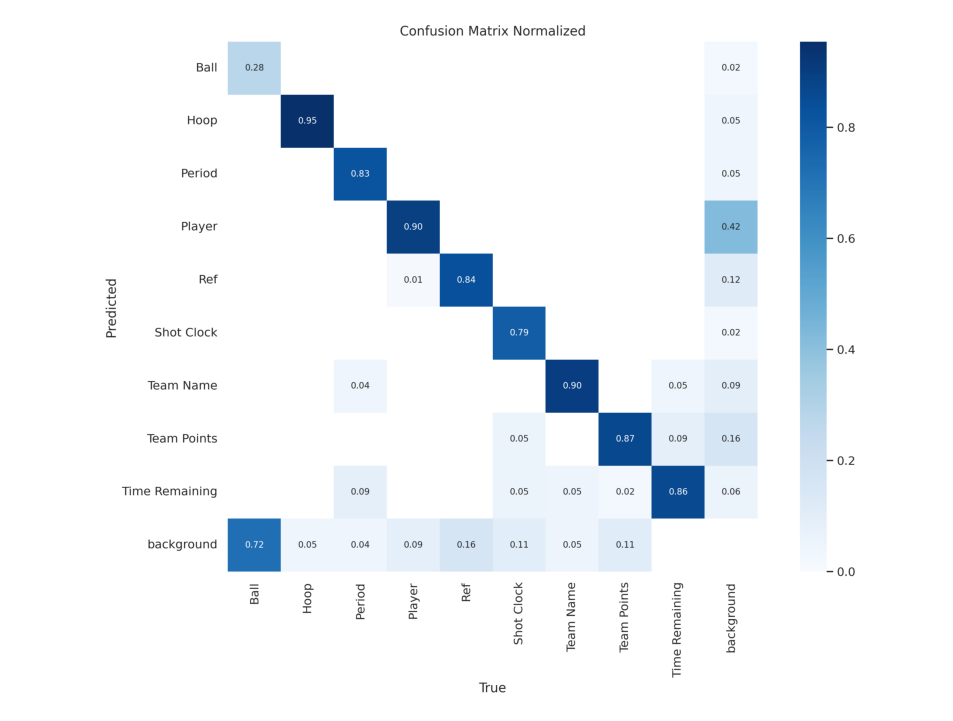

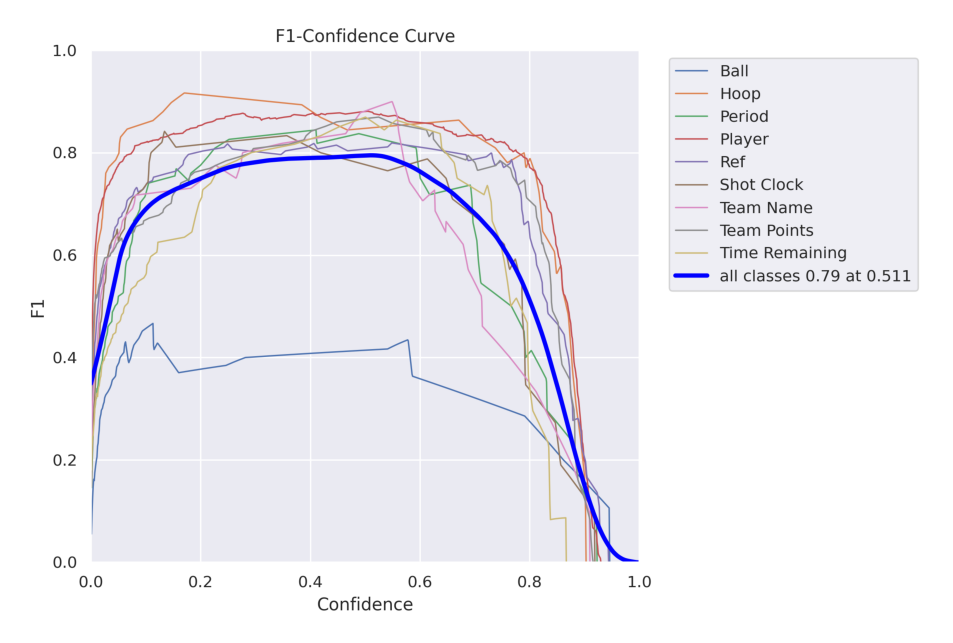

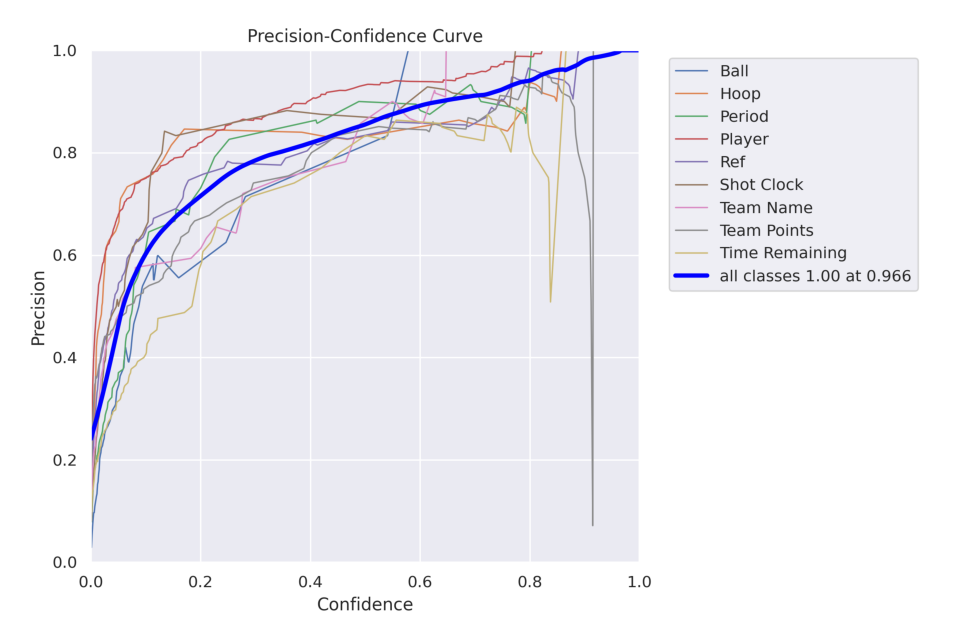

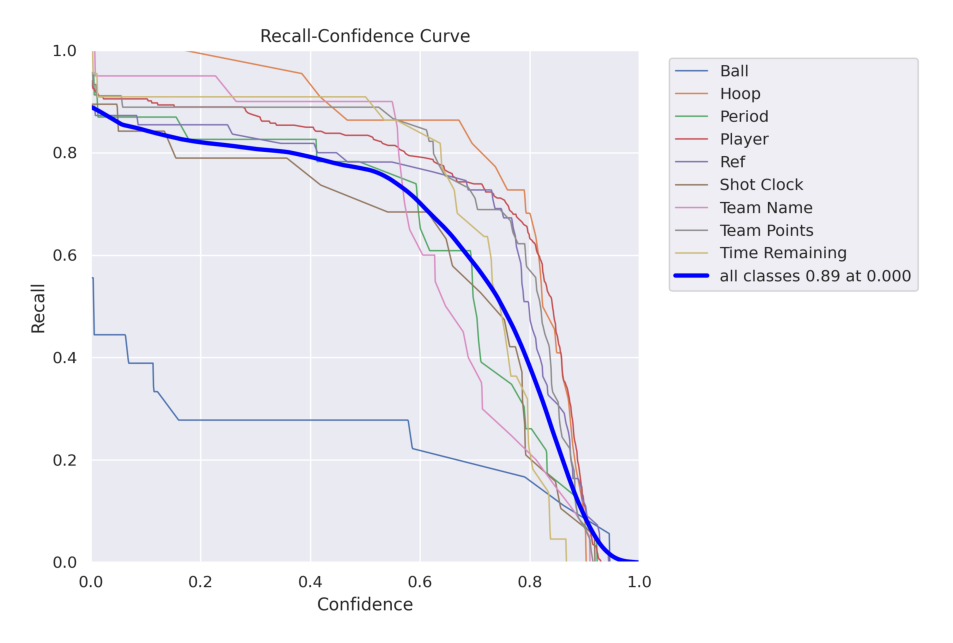

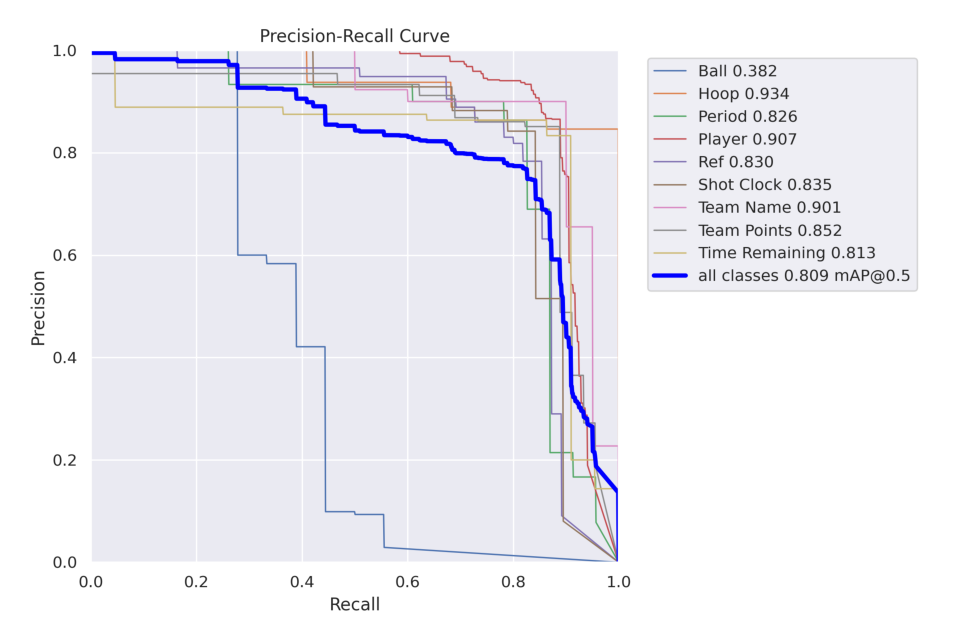

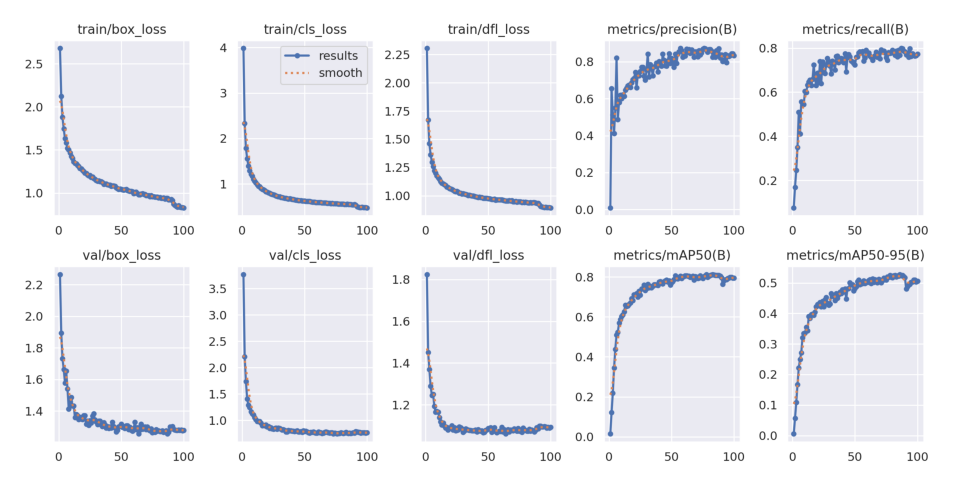

In [22]:
# Path to the directory containing the images
post_training_files_path = '/home/alide/Notebooks/ProyectoPC/runs/detect/train3'

# Display the images
display_images(post_training_files_path, image_files)

### Best performing model and example

In [23]:
# Loading the best performing model
Final_model_v11 = YOLO('/home/alide/Notebooks/ProyectoPC/runs/detect/train3/weights/best.pt')

# Evaluating the model on the validset
metrics = Final_model_v11.val(split = 'val')

# final results 
print("precision(B): ", metrics.results_dict["metrics/precision(B)"])
print("metrics/recall(B): ", metrics.results_dict["metrics/recall(B)"])
print("metrics/mAP50(B): ", metrics.results_dict["metrics/mAP50(B)"])
print("metrics/mAP50-95(B): ", metrics.results_dict["metrics/mAP50-95(B)"])

Ultralytics 8.3.106 🚀 Python-3.10.14 torch-2.3.1+cu121 CPU (AMD Ryzen 5 5500)
YOLO11n summary (fused): 100 layers, 2,583,907 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/valid/labels.cache... 32 images, 0 backgrounds, 0
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2


                   all         32        477       0.86      0.768      0.809      0.528
                  Ball         18         18      0.819      0.278      0.382      0.182
                  Hoop         22         22      0.834      0.864      0.934      0.705
                Period         22         23      0.899      0.773      0.826      0.552
                Player         31        253      0.933      0.832      0.907      0.562
                   Ref         28         55      0.836      0.782       0.83      0.547
            Shot Clock         19         19      0.869      0.697      0.835      0.464
             Team Name         10         20      0.871        0.9      0.901      0.585
           Team Points         22         45      0.848      0.889      0.852      0.593
        Time Remaining         22         22      0.831      0.896      0.813      0.557
Speed: 0.7ms preprocess, 31.7ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs/detec

#### Exporting the model

In [24]:
#Export the model
Final_model_v11.export(format='onnx')

Ultralytics 8.3.106 🚀 Python-3.10.14 torch-2.3.1+cu121 CPU (AMD Ryzen 5 5500)

PyTorch: starting from '/home/alide/Notebooks/ProyectoPC/runs/detect/train3/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 13, 8400) (5.2 MB)
requirements: Ultralytics requirement ['onnxslim'] not found, attempting AutoUpdate...
requirements: ❌ AutoUpdate skipped (offline)

ONNX: starting export with onnx 1.17.0 opset 17...
ONNX: simplifier failure: No module named 'onnxslim'
ONNX: export success ✅ 0.6s, saved as '/home/alide/Notebooks/ProyectoPC/runs/detect/train3/weights/best.onnx' (10.1 MB)

Export complete (0.7s)
Results saved to /home/alide/Notebooks/ProyectoPC/runs/detect/train3/weights
Predict:         yolo predict task=detect model=/home/alide/Notebooks/ProyectoPC/runs/detect/train3/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=/home/alide/Notebooks/ProyectoPC/runs/detect/train3/weights/best.onnx imgsz=640 data=/mnt/c/Users/alide/IA/Proyect

'/home/alide/Notebooks/ProyectoPC/runs/detect/train3/weights/best.onnx'

#### Example using Final_Model with the same img used with the pre trained model


image 1/1 /mnt/c/Users/alide/IA/Proyecto/BasketballYv8/test/images/youtube-128_jpg.rf.9c69a0f24eb15649f6d5bd2f1a9d47a2.jpg: 384x640 1 Hoop, 1 Period, 10 Players, 3 Refs, 1 Shot Clock, 2 Team Pointss, 1 Time Remaining, 50.8ms
Speed: 1.6ms preprocess, 50.8ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


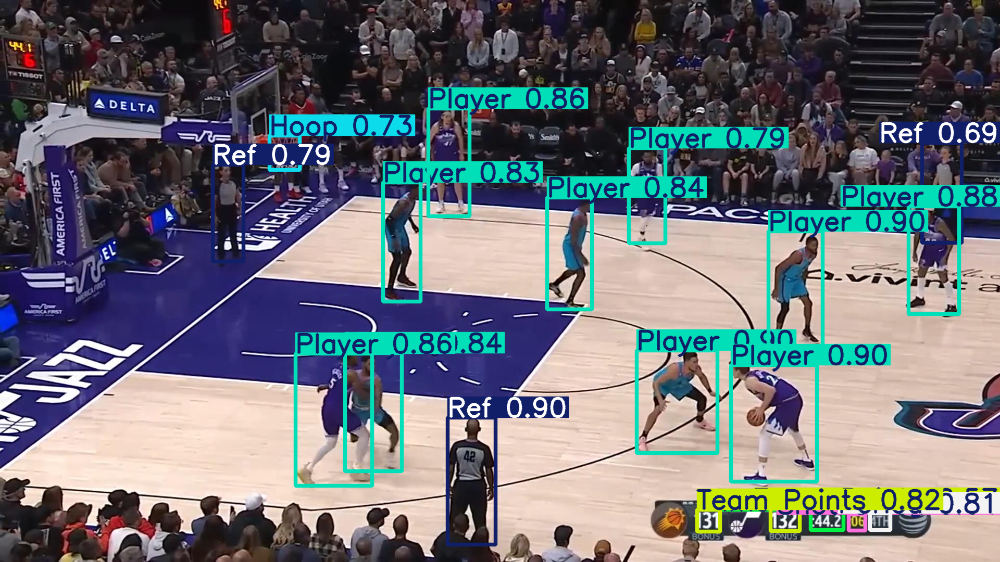

In [25]:
result_predict = Final_model_v11.predict(source = image_example, imgsz=(640))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

### FInal Model architecture

In [26]:
Final_model_v11

YOLO(
  (model): DetectionModel(
    (model): Sequential(
      (0): Conv(
        (conv): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (act): SiLU(inplace=True)
      )
      (1): Conv(
        (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (act): SiLU(inplace=True)
      )
      (2): C3k2(
        (cv1): Conv(
          (conv): Conv2d(32, 32, kernel_size=(1, 1), stride=(1, 1))
          (act): SiLU(inplace=True)
        )
        (cv2): Conv(
          (conv): Conv2d(48, 64, kernel_size=(1, 1), stride=(1, 1))
          (act): SiLU(inplace=True)
        )
        (m): ModuleList(
          (0): Bottleneck(
            (cv1): Conv(
              (conv): Conv2d(16, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (act): SiLU(inplace=True)
            )
            (cv2): Conv(
              (conv): Conv2d(8, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (act): SiLU(inplace=True)
    